# Setup

## Pip install

In [3]:
# Don't forget to restart runtime after installing

%pip install "labelbox[data]" --quiet
%pip install -U kaleido  --quiet # for saving the still figures
%pip install poppler-utils   # for exporting to .eps extension
%pip install plotly==5.7.0.    # need 5.7.0, not 5.5, so I can use ticklabelstep argument
# %pip freeze
# %pip freeze | grep matplotlib  # get version

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Base imports


In [4]:
import os
import sys
print(sys.version)
import json
import numpy as np
import pandas as pd
import scipy
import scipy.stats
import statsmodels.api as sm
import statsmodels.formula.api as smf

import skimage
import skimage.io
#from PIL import Image
import PIL
import PIL.Image
import requests

#import labelbox
#from labelbox.data.annotation_types import Geometry

import IPython.display
import matplotlib
import matplotlib.pyplot as plt
import plotly
import plotly.express as px

3.7.13 (default, Apr 24 2022, 01:04:09) 
[GCC 7.5.0]


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [5]:

notebook_filename = requests.get("http://172.28.0.2:9000/api/sessions").json()[0]["name"]

# Avoids scroll-in-the-scroll in the entire Notebook
def resize_colab_cell():
  display(IPython.display.Javascript('google.colab.output.setIframeHeight(0, true, {maxHeight: 10000})'))
get_ipython().events.register('pre_run_cell', resize_colab_cell)


#@markdown ### func `def get_path_to_save(...):`
def get_path_to_save(plot_props:dict=None, file_prefix="", save_filename:str=None, save_in_subfolder:str=None, extension="jpg", create_folder_if_necessary=True):
    """
    Code created myself (Rahul Yerrabelli)
    """
    replace_characters = {
        "$": "",
        "\\frac":"",
        "\\mathrm":"",
        "\\left(":"(",
        "\\right)":")",
        "\\left[":"[",
        "\\right]":"]",
        "\\": "",
        "/":"-",
        "{": "(",
        "}": ")",
        "<":"",
        ">":"",
        "?":"",
        "_":"",
        "^":"",
        "*":"",
        "!":"",
        ":":"-",
        "|":"-",
        ".":"_",
    }

    # define save_filename based on plot_props
    if save_filename is None:
        save_filename = "unnamed"

    #save_path = f"../outputs/{notebook_filename.split('.',1)[0]}"
    save_path = [
                 "outputs",
                f"{notebook_filename.split('.',1)[0]}",
                ]
    if save_in_subfolder is not None:
        if isinstance(save_in_subfolder, (list, tuple, set, np.ndarray) ):
            save_path.append(**save_in_subfolder)
        else:  # should be a string then
            save_path.append(save_in_subfolder)
    save_path = os.path.join(*save_path)

    if not os.path.exists(save_path) and create_folder_if_necessary:
        os.makedirs(save_path)
    print(os.path.join(save_path, file_prefix+save_filename+"."+extension))
    return os.path.join(save_path, file_prefix+save_filename+"."+extension)
    #plt.savefig(os.path.join(save_path, save_filename+"."+extension))



In [6]:
#@title ## Mount google drive and import my code

mountpoint_folder_name = "drive"  # can be anything, doesn't have to be "drive"
project_path_within_drive = "PythonProjects/SpeculumAnalysis" #@param {type:"string"}
#project_path_within_drive = "UIUC ECs/Rahul_Ashkhan_Projects/SpeculumProjects_Shared/Analysis" #@param {type:"string"}
project_path_full = os.path.join("/content/",mountpoint_folder_name,
                        "MyDrive",project_path_within_drive)

%cd {project_path_full}

<IPython.core.display.Javascript object>

/content/drive/MyDrive/Computer Backups/Rahul Yerrabelli drive/PythonProjects/SpeculumAnalysis


In [6]:

try:
    import google.colab.drive
    import os, sys
    # Need to move out of google drive directory if going to remount
    %cd
    # drive.mount documentation can be accessed via: drive.mount?
    #Signature: drive.mount(mountpoint, force_remount=False, timeout_ms=120000, use_metadata_server=False)
    google.colab.drive.mount(os.path.join("/content/",mountpoint_folder_name), force_remount=True)  # mounts to a folder called mountpoint_folder_name

    if project_path_full not in sys.path:
        pass
        #sys.path.insert(0,project_path_full)
    %cd {project_path_full}
    
except ModuleNotFoundError:  # in case not run in Google colab
    import traceback
    traceback.print_exc()

<IPython.core.display.Javascript object>

/root
Mounted at /content/drive
/content/drive/MyDrive/Computer Backups/Rahul Yerrabelli drive/PythonProjects/SpeculumAnalysis


# Skip ahead from loaded code

In [7]:
speculum_df_raw = pd.read_pickle("data/02_intermediate/speculum_df_raw"+".pkl")
speculum_df_notfailed = pd.read_pickle("data/02_intermediate/speculum_df_notfailed"+".pkl")

labels_df = pd.read_csv("data/02_intermediate/labels_df.csv", index_col=0)
#with open("data/02_intermediate/label_from_id_dict"+".json", "r") as infile:
#    label_from_id_dict = json.load(infile)
    
df_long = pd.read_pickle(  "data/03_processed/combined_df_long.pkl")
df_wide = pd.read_pickle(  "data/03_processed/combined_df_wide.pkl")
df_wide_flat = pd.read_pickle(  "data/03_processed/combined_df_wide_flat.pkl")

df_agg_long = pd.read_pickle("data/04_aggregated/combined_df_agg_long.pkl")
df_agg_long_flat = pd.read_pickle("data/04_aggregated/combined_df_agg_long_flat.pkl")

df_multiindex = pd.read_pickle("data/03_processed/combined_df_multiindex"+".pkl")


<IPython.core.display.Javascript object>

# Set up for displaying

## Setup dicts and helper functions

In [8]:
category_orders={"Size": ["S", "M", "L","Unspecified","None"],
                 "Material":["Nitrile","Vinyl","Trojan", "Lifestyle", "Durex", "Skyn","None"],
                 "Material Type":["Glove","Condom","None"],
                 "Method":["Middle","Two","Palm","Middle finger","Two fingers","Palm","Precut","None"],
                 "Speculum Type":["White","Green"]}
labels = {
    "Trial":"Trial #",
    "wd_rel":"Relative Obstruction",
    "wd_rel.mean":"Mean Relative Obstruction (S.E.)", 
    "mmHg":"Pressure (mmHg)", 
    "Material":"Material", "Material Type":"Material Type"
    }


def criteria_to_str(criteria:dict) -> str:
    return ", ".join([f"{labels.get(key) or key}={val}" for key,val in criteria.items()])


def filter_by_criteria(criteria:dict, starting_df:pd.DataFrame) -> pd.DataFrame:
    #df_sampled = df_agg_long_flat.loc[ np.all([df_agg_long[arg]==val for arg, val in criteria.items()], axis=0) ]
    #df_sampled = df_agg_long_flat.loc[ np.all([ (type(val)!=list and df_agg_long[arg]==val ) or np.in1d(df_agg_long[arg],val)  for arg, val in criteria.items()], axis=0) ]
    #starting_df.loc[ np.all([ (type(val)!=list and starting_df[arg]==val ) or np.in1d(starting_df[arg],val)  for arg, val in criteria.items()], axis=0) ]
    conditions = []
    for arg, val in criteria.items():
        if hasattr(val,"__iter__") and not isinstance(val,str):
            conditions.append( np.in1d(starting_df[arg],val) )
        else:
            conditions.append( starting_df[arg]==val )
    return starting_df.loc[ np.all(conditions, axis=0) ]

<IPython.core.display.Javascript object>

## Setup  plotly

In [9]:
default_plotly_save_scale = 4
def save_plotly_figure(fig, file_name:str, animated=False, scale=None, save_in_subfolder:str=None, extensions=None):
    """
    - for saving plotly.express figures only - not for matplotlib
    - fig is of type plotly.graph_objs._figure.Figure,
    - Requires kaleido installation for the static (non-animated) images
    """    
    if scale is None:
        scale = default_plotly_save_scale
    if extensions is None:
        extensions = ["html"]
        if not animated:
            # options = ['png', 'jpg', 'jpeg', 'webp', 'svg', 'pdf', 'eps', 'json']
            extensions += ["eps","png","pdf"]

    for extension in extensions:
        try:
            if extension in ["htm","html"]:
                    fig.write_html( get_path_to_save(save_filename=file_name, save_in_subfolder=save_in_subfolder, extension=extension), 
                        full_html=False,
                        include_plotlyjs="directory" )
            else:
                fig.write_image(get_path_to_save(save_filename=file_name, save_in_subfolder=save_in_subfolder, extension=extension), scale=scale)
        except ValueError as exc:
            import traceback
            #traceback.print_exception()

#col_options = {col_name:pd.unique(df_long[col_name]).tolist() for col_name in consistent_cols}
#display(col_options)

<IPython.core.display.Javascript object>

# Plotting

## Display images

#### Matplotlib plots (old)

##### Define image plotting function

In [18]:
def plot_combined_images(order_current, label_dict, df_long=df_long, nrows=2, ncols=3, do_save=True, do_print=False, dpi=None, annotate_extra_info=True):
    # default dpi is 72
    filenames= list(df_long[df_long["Order"]==order_current].Filename)  # list converts form pd.Series
    if len(filenames)==0:
        return None
    else:
        assert len(filenames) == 6, f"For order_current={order_current}, the len(filenames)=={len(filenames)}, when it should be 6. filenames={filenames}"


    plt.rcParams['text.usetex'] = False   # for Latex
    fig = plt.figure(figsize=(6,8), dpi=dpi)   #figsize=(16,12)  # wd,ht in in
    axes = fig.subplots(nrows=nrows, ncols=ncols, 
                        sharey=True, sharex=True
                        )



    data_rows = {}
    for ind in range(nrows*ncols):
        label = label_dict[filenames[ind]]
        filename = label.data.external_id
        box_size = {"x":label.annotations[0].value.end.x - label.annotations[0].value.start.x,  "y":label.annotations[0].value.end.y - label.annotations[0].value.start.y}
        annotations = label.annotations
        # image_np.shape is (2268, 4032, 3)  
        # This is a 16:9 (x252) aspect ratio
        # 4032 = 2^6 x 3^2 x 7
        # 2268 = 2^2 x 3^4 x 7
        image_np = label.data.value   


        data_row = df_long.loc[df_long["Filename"]==filename].squeeze()  # squeeze removes the additional index dimension to make a 1D pandas series 
        data_rows[data_row['Order']] = data_row
        if data_row['Material Type'] == "Glove":
            data_row_str = [
                            f"'{data_row['Method']} finger' method" ,
                            f"with {data_row['Size']}. {data_row['Material'].lower()} glove," " " f"Trial #{data_row['Trial']}"
                            ]
            data_row_elem_str = [
                            f"'{data_row['Method']} finger' method" " " f"at {data_row['mmHg']}mmHg",
                            f"with {data_row['Size']}. {data_row['Material'].lower()} glove," " " f"Trial #{data_row['Trial']}"
                            ]
        elif data_row['Material Type'] == "Condom":
            data_row_str = [f"{data_row['Material']} brand condom," " " f"Trial #{data_row['Trial']}"
                            ]
            data_row_elem_str = [
                            f"{data_row['Material']} brand condom" " " f"at {data_row['mmHg']}mmHg," " " f"Trial #{data_row['Trial']}"
                            ]
        elif data_row['Material Type'] == "None":
            data_row_str = [f"No material," " " f"Trial #{data_row['Trial']}"
                            ]
            data_row_elem_str = [
                            f"No material" " " f"at {data_row['mmHg']}mmHg," " " f"Trial #{data_row['Trial']}"
                            ]
        else:
            assert False

        if do_print:
            print(filename + "\t " + " ".join(data_row_elem_str))

        # Draw the annotations onto the source image
        for annotation in annotations:
            if isinstance(annotation.value, labelbox.data.annotation_types.Geometry):
                image_np = annotation.value.draw(canvas=image_np,
                                                color=colors[annotation.name],
                                                thickness=10)


        image_np = np.rot90(image_np, k=(1 if data_row['Material Type']=="Glove" else 0) )

        axes.flat[ind].imshow(image_np)
        if annotate_extra_info:
            #axes.flat[ind].text( image_np.shape[0]*0.02, image_np.shape[0]*0.02, filename, color="blue", fontsize=6, ha='left',va="top")
            axes.flat[ind].text( image_np.shape[0]*0.02, image_np.shape[0]*0.95, filename, color="blue", fontsize=6, ha='left',va="top",
                                bbox=dict(boxstyle="square", ec=(0.5, 0.5, 0.5),fc=(0.8, 0.8, 0.8, 0.6),
                                        ))
        #axes.flat[ind].text( image_np.shape[0]*0.02, image_np.shape[0]*0.98,  "\n".join(data_row_elem_str), color="blue", fontsize=5, ha='left',va="bottom")
        # Note, the x-y nomenclature is confusing because of the 90 deg rotation
        axes.flat[ind].set_xlabel(f"Δx = {box_size['y']:.0f}px",fontsize=8)
        #axes.flat[ind].set_ylabel(f"Δy = {box_size['x']:.0f}px",fontsize=8)
        axes.flat[ind].set_title(f"At {data_row['mmHg']}mmHg", fontsize=10,fontweight="bold")


    for ind,ax in enumerate(axes.flat):
        ax.grid(which="major", alpha=0.75)  # set major grid lines
        ax.grid(which="minor", alpha=0.5, linestyle=":")  # set minor grid lines, but make them less visible
        ax.xaxis.set_minor_locator(matplotlib.ticker.AutoMinorLocator())
        ax.yaxis.set_minor_locator(matplotlib.ticker.AutoMinorLocator())

    fig.suptitle("Speculum Image Data", fontsize=20, fontweight="bold")
    fig.suptitle(" ".join(data_row_str),
            fontsize=12,
            fontweight="bold")

    plt.tight_layout(rect=[0,0.05,1,0.95]) # rect=[left, bottom, right top]

    """
    data_rows_df = pd.DataFrame(data_rows)
    col_names = ["Order","Size", "Material", "Method", "Trial"]
    common_args = []
    for col_name in col_names:
        if (data_rows_df[col_name].iloc[0]==data_rows_df[col_name]).all():
            common_args.append(col_name + "=" + str(data_rows_df[col_name].iloc[0]))
    #(data_rows_df["Size"].iloc[0]==data_rows_df["Size"]).all()
    print()"""


    if do_save:
        dpi = fig.dpi
        data_row_str_clean = " ".join(data_row_str)
        data_row_str_clean = data_row_str_clean.replace("#","".replace(".",""))
        plt.savefig(get_path_to_save(save_filename=f"Trial {order_current}) " + " ".join(data_row_str) + f", dpi={dpi}", save_in_subfolder="Each Trial - Matplotlib"), 
                    bbox_inches='tight')  # Include the bbox_inches='tight' is critical to ensure the saved images aren't cutoff while the colab images are normal


<IPython.core.display.Javascript object>

##### Plot the images

In [13]:
%pip install "labelbox[data]" --quiet

<IPython.core.display.Javascript object>

In [14]:
import labelbox

# Add your labelbox api key and project
# Labelbox API stored in separate file since it is specific for a labelbox 
#account and shouldn't be committed to git. Contact the 
# team (i.e. Rahul Yerrabelli) in order to access to the data on your own account.
with open("auth/LABELBOX_API_KEY.json", "r") as infile:
  json_data = json.load(infile)
API_KEY = json_data["API_KEY"]
del json_data   # delete sensitive info

PROJECT_ID = "cl2cept1u4ees0zbx6uan5kwa"
DATASET_ID_Glove = "cl2cerkwd5gtd0zcahfz98401"; DATASET_NAME_Glove = "SpeculumWithGlove"
DATASET_ID_Condom = "cl2hu1u8z019a0z823yl5f8gr"; DATASET_NAME_Condom = "SpeculumWithCondom"

client = labelbox.Client(api_key=API_KEY)
del API_KEY   # delete sensitive info
project = client.get_project(PROJECT_ID)
dataset_glove = client.get_dataset(DATASET_ID_Glove)
dataset_condom = client.get_dataset(DATASET_ID_Condom)
# Alternative way to get dataset
# dataset = next(client.get_datasets(where=(labelbox.Dataset.name == DATASET_NAME)))

# Below code is from labelbox tutorial
# Create a mapping for the colors
hex_to_rgb = lambda hex_color: tuple(
    int(hex_color[i + 1:i + 3], 16) for i in (0, 2, 4))
colors = {
    tool.name: hex_to_rgb(tool.color)
    for tool in labelbox.OntologyBuilder.from_project(project).tools
}

<IPython.core.display.Javascript object>

In [15]:
image_labels = project.label_generator()
image_labels = image_labels.as_list()
labels_df = pd.DataFrame([[
                           label.data.external_id, 
                           label.annotations[0].value.end.x - label.annotations[0].value.start.x, 
                           label.annotations[0].value.end.y - label.annotations[0].value.start.y, 
                           label.annotations[0].value.start.x, 
                           label.annotations[0].value.start.y, 
                           label.data.url, 
                           label.uid
                           ] 
                          for label in image_labels],
                         columns=["Filename","x","y", "xstart","ystart","url", "Label ID"])

label_from_id_dict = {label.data.external_id: label for label in image_labels}
#with open("data/02_intermediate/label_from_id_dict"+".json", "w") as outfile:
#    json.dump(label_from_id_dict, outfile)   # Error: Object of type Label is not JSON serializable 


<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/labelbox/data/annotation_types/classification/classification.py:85: UserWarning: Dropdown classification is deprecated and will be removed in a future release
  warnings.warn("Dropdown classification is deprecated and will be "


In [ ]:
image_labels = project.label_generator()
image_labels = image_labels.as_list()
label_dict = {label.data.external_id: label for label in image_labels}


#order_current = 4
#plot_combined_images(order_current=order_current, label_dict=label_from_id_dict, do_print=True, dpi=150)

# condom category starts at order=22
#for order_current in range(22, df_long["Order"].max()+1):
#    plot_combined_images(order_current=order_current, label_dict=label_from_id_dict, do_print=True, dpi=150)


<IPython.core.display.Javascript object>

20220423_142023.jpg	 'Middle finger' method at 0mmHg with M. nitrile glove, Trial #1
20220423_142031.jpg	 'Middle finger' method at 40mmHg with M. nitrile glove, Trial #1
20220423_142049.jpg	 'Middle finger' method at 80mmHg with M. nitrile glove, Trial #1
20220423_142054.jpg	 'Middle finger' method at 120mmHg with M. nitrile glove, Trial #1
20220423_142100.jpg	 'Middle finger' method at 160mmHg with M. nitrile glove, Trial #1
20220423_142108.jpg	 'Middle finger' method at 200mmHg with M. nitrile glove, Trial #1


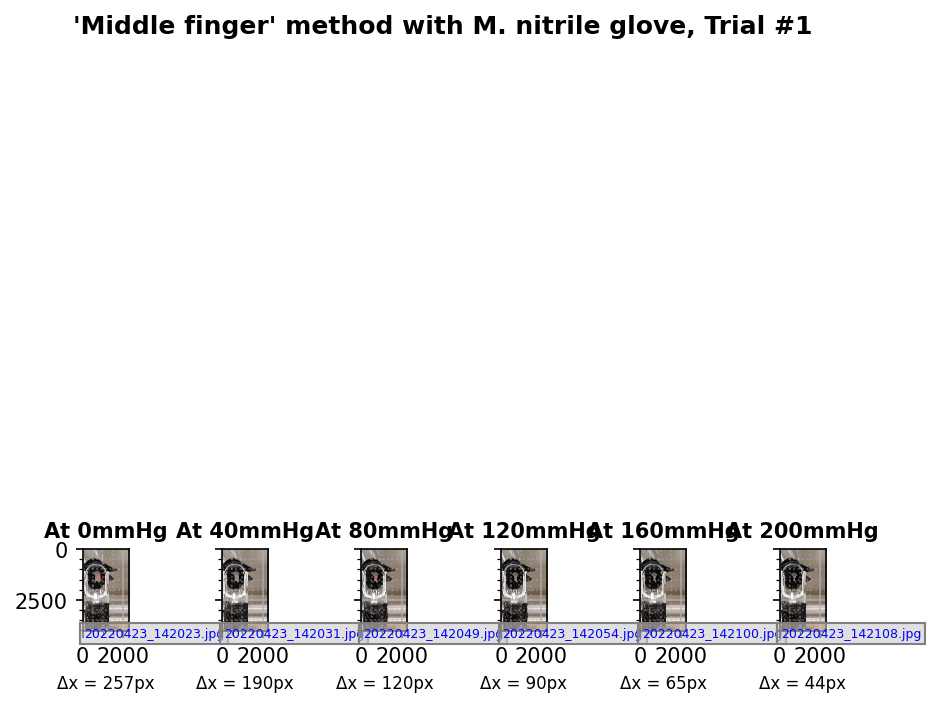

In [20]:
order_current = 1
plot_combined_images(order_current=order_current, label_dict=label_from_id_dict, nrows=1, ncols=6, do_print=True, dpi=150, annotate_extra_info=True)

### Matplotlib updated (old)

In [ ]:
def plot_combined_images2(order_current, df_long=df_long, do_save=True, do_print=False, dpi=None, annotate_extra_info=True):
    if order_current is None:
        order_current=0
        #order_current=order_current+1

    df_sampled = df_long.loc[df_long.Order==order_current]
    while df_sampled.shape[0]==0:  # skip ahead for empty order_currents
        return False
        #order_current=order_current+1 if order_current < df_long.Order.max() else 0
        #df_sampled = df_long.loc[df_long.Order==order_current]

    data_row = df_sampled.iloc[0] # get first row
    base_row = df_sampled.loc[df_sampled.mmHg==0].squeeze()

    base_folder = os.path.join("data/01_raw/photos/", ("glove" if data_row["Material Type"]=="Glove" else "condom/orig"))
    images = np.array([skimage.io.imread( os.path.join(base_folder, filename))  for filename in df_sampled.Filename])
    # rotate
    # images = np.rot90(images, k=1, axes=(1,2))
    dim = images.shape[1:]  # should be 3 values, with the last being color dim


    # default dpi is 72
    nrows = 1
    ncols = 6
    filenames= list(df_long[df_long["Order"]==order_current].Filename)  # list converts form pd.Series
    if len(filenames)==0:
        return None
    else:
        assert len(filenames) == 6, f"For order_current={order_current}, the len(filenames)=={len(filenames)}, when it should be 6. filenames={filenames}"


    plt.rcParams['text.usetex'] = False   # for Latex
    fig = plt.figure(figsize=(6,8), dpi=dpi)   #figsize=(16,12)  # wd,ht in in
    axes = fig.subplots(nrows=nrows, ncols=ncols, 
                        sharey=True, sharex=True
                        )

    data_rows = {}
    for ind in range(nrows*ncols):
        label = label_dict[filenames[ind]]
        filename = label.data.external_id
        box_size = {"x":label.annotations[0].value.end.x - label.annotations[0].value.start.x,  "y":label.annotations[0].value.end.y - label.annotations[0].value.start.y}
        annotations = label.annotations
        # image_np.shape is (2268, 4032, 3)  
        # This is a 16:9 (x252) aspect ratio
        # 4032 = 2^6 x 3^2 x 7
        # 2268 = 2^2 x 3^4 x 7
        image_np = label.data.value   


        data_row = df_long.loc[df_long["Filename"]==filename].squeeze()  # squeeze removes the additional index dimension to make a 1D pandas series 
        data_rows[data_row['Order']] = data_row
        if data_row['Material Type'] == "Glove":
            data_row_str = [
                            f"'{data_row['Method']} finger' method" ,
                            f"with {data_row['Size']}. {data_row['Material'].lower()} glove," " " f"Trial #{data_row['Trial']}"
                            ]
            data_row_elem_str = [
                            f"'{data_row['Method']} finger' method" " " f"at {data_row['mmHg']}mmHg",
                            f"with {data_row['Size']}. {data_row['Material'].lower()} glove," " " f"Trial #{data_row['Trial']}"
                            ]
        elif data_row['Material Type'] == "Condom":
            data_row_str = [f"{data_row['Material']} brand condom," " " f"Trial #{data_row['Trial']}"
                            ]
            data_row_elem_str = [
                            f"{data_row['Material']} brand condom" " " f"at {data_row['mmHg']}mmHg," " " f"Trial #{data_row['Trial']}"
                            ]
        elif data_row['Material Type'] == "None":
            data_row_str = [f"No material," " " f"Trial #{data_row['Trial']}"
                            ]
            data_row_elem_str = [
                            f"No material" " " f"at {data_row['mmHg']}mmHg," " " f"Trial #{data_row['Trial']}"
                            ]
        else:
            assert False

        if do_print:
            print(filename + "\t " + " ".join(data_row_elem_str))

        # Draw the annotations onto the source image
        for annotation in annotations:
            if isinstance(annotation.value, labelbox.data.annotation_types.Geometry):
                image_np = annotation.value.draw(canvas=image_np,
                                                color=colors[annotation.name],
                                                thickness=10)


        image_np = np.rot90(image_np, k=(1 if data_row['Material Type']=="Glove" else 0) )

        axes.flat[ind].imshow(image_np)
        if annotate_extra_info:
            #axes.flat[ind].text( image_np.shape[0]*0.02, image_np.shape[0]*0.02, filename, color="blue", fontsize=6, ha='left',va="top")
            axes.flat[ind].text( image_np.shape[0]*0.02, image_np.shape[0]*0.95, filename, color="blue", fontsize=6, ha='left',va="top",
                                bbox=dict(boxstyle="square", ec=(0.5, 0.5, 0.5),fc=(0.8, 0.8, 0.8, 0.6),
                                        ))
        #axes.flat[ind].text( image_np.shape[0]*0.02, image_np.shape[0]*0.98,  "\n".join(data_row_elem_str), color="blue", fontsize=5, ha='left',va="bottom")
        # Note, the x-y nomenclature is confusing because of the 90 deg rotation
        axes.flat[ind].set_xlabel(f"Δx = {box_size['y']:.0f}px",fontsize=8)
        #axes.flat[ind].set_ylabel(f"Δy = {box_size['x']:.0f}px",fontsize=8)
        axes.flat[ind].set_title(f"At {data_row['mmHg']}mmHg", fontsize=10,fontweight="bold")


    for ind,ax in enumerate(axes.flat):
        ax.grid(which="major", alpha=0.75)  # set major grid lines
        ax.grid(which="minor", alpha=0.5, linestyle=":")  # set minor grid lines, but make them less visible
        ax.xaxis.set_minor_locator(matplotlib.ticker.AutoMinorLocator())
        ax.yaxis.set_minor_locator(matplotlib.ticker.AutoMinorLocator())

    fig.suptitle("Speculum Image Data", fontsize=20, fontweight="bold")
    fig.suptitle(" ".join(data_row_str),
            fontsize=12,
            fontweight="bold")

    plt.tight_layout(rect=[0,0.05,1,0.95]) # rect=[left, bottom, right top]

    """
    data_rows_df = pd.DataFrame(data_rows)
    col_names = ["Order","Size", "Material", "Method", "Trial"]
    common_args = []
    for col_name in col_names:
        if (data_rows_df[col_name].iloc[0]==data_rows_df[col_name]).all():
            common_args.append(col_name + "=" + str(data_rows_df[col_name].iloc[0]))
    #(data_rows_df["Size"].iloc[0]==data_rows_df["Size"]).all()
    print()"""


    if do_save:
        dpi = fig.dpi
        data_row_str_clean = " ".join(data_row_str)
        data_row_str_clean = data_row_str_clean.replace("#","".replace(".",""))
        plt.savefig(get_path_to_save(save_filename=f"Trial {order_current}) " + " ".join(data_row_str) + f", dpi={dpi}", save_in_subfolder="Each Trial - Matplotlib"), 
                    bbox_inches='tight')  # Include the bbox_inches='tight' is critical to ensure the saved images aren't cutoff while the colab images are normal


### Plotly plots (new)

#### Plotting trial images 
(trying in plotly instead of matplotlib above)

In [ ]:
filename = "20220423_142023.jpg"
df_sampled = df_long.loc[df_long["Filename"]==filename]

with PIL.Image.open(f'data/01_raw/photos/glove/{filename}') as image_orig:
    image = image_orig.rotate(90, expand=True)
    # summarize some details about the image
    print(image.format)
    print(image.size)
    print(image.mode)
    dim = image.size

    #fig = px.imshow(image, aspect="equal")  # aspect="equal" constrains to square pixels instead of natural blending - less visually appealing, but more similar to the actual image data
    #image2 = np.rot90(
    fig = px.imshow(image)

    # Shape defined programatically
    fig.add_shape(
        type='rect',
        x0=df_sampled.wd_start[0], x1=df_sampled.wd_start[0]+df_sampled.wd[0], 
        y0=dim[1]-df_sampled.ht_start[0], y1=dim[1]-(df_sampled.ht_start[0]+df_sampled.ht[0]),
        xref='x', yref='y',
        line=dict(
            color="red",
            width=4,
            dash="dot",
        )
    )

    fig.show()


#### Plotting trial images - subplots

In [14]:
# figure size in px

facet_col_wrap = 6
if facet_col_wrap==6:
    width  = 1100*2
    height =  300*2
elif facet_col_wrap==3:
    width  = 500*2
    height =  600*2
else:
    assert False


#col_options = {col_name:pd.unique(df_long[col_name]).tolist() for col_name in consistent_cols}
#display(col_options)

def plot_combined_images_plotly(order_current, df_long=df_long, do_save=True, save_scale=None, save_extensions=None, n=None, annotate_extra_info=True):
    if order_current is None:
        order_current=0
        #order_current=order_current+1

    df_sampled = df_long.loc[df_long.Order==order_current]
    while df_sampled.shape[0]==0:  # skip ahead for empty order_currents
        return False
        #order_current=order_current+1 if order_current < df_long.Order.max() else 0
        #df_sampled = df_long.loc[df_long.Order==order_current]

    data_row = df_sampled.iloc[0] # get first row
    base_row = df_sampled.loc[df_sampled.mmHg==0].squeeze()

    base_folder = os.path.join("data/01_raw/photos/", ("glove" if data_row["Material Type"]=="Glove" else "condom/orig"))
    images = np.array([skimage.io.imread( os.path.join(base_folder, filename))  for filename in df_sampled.Filename])
    # rotate
    # images = np.rot90(images, k=1, axes=(1,2))
    dim = images.shape[1:]  # should be 3 values, with the last being color dim
    dim_small = tuple([int(dim[0]/n), int(dim[1]/n), *dim[2:]])



    if data_row['Material Type'] == "Glove":
        data_row_str = [
                        f"'{data_row['Method']} finger' method" ,
                        f"with {data_row['Size']}. {data_row['Material'].lower()} glove," " " f"Trial #{data_row['Trial']}"
                        ]
        data_row_elem_str = [
                        f"'{data_row['Method']} finger' method" " " f"at {data_row['mmHg']}mmHg",
                        f"with {data_row['Size']}. {data_row['Material'].lower()} glove," " " f"Trial #{data_row['Trial']}"
                        ]
    elif data_row['Material Type'] == "Condom":
        data_row_str = [f"{data_row['Material']} brand condom," " " f"Trial #{data_row['Trial']}"
                        ]
        data_row_elem_str = [
                        f"{data_row['Material']} brand condom" " " f"at {data_row['mmHg']}mmHg," " " f"Trial #{data_row['Trial']}"
                        ]
    elif data_row['Material Type'] == "None":
        data_row_str = [f"No material," " " f"Trial #{data_row['Trial']}"
                        ]
        data_row_elem_str = [
                        f"No material" " " f"at {data_row['mmHg']}mmHg," " " f"Trial #{data_row['Trial']}"
                        ]


    
    def ind_to_row(index):
        return 6//facet_col_wrap - ((index // facet_col_wrap))   # // is integer division (divison without remainder)
    def ind_to_col(index):
        return (index %  facet_col_wrap) + 1   # % is modulus operator

    fig = px.imshow( images[:, ::n, ::n, :], binary_string=True, origin="lower", aspect="equal",
                    facet_col=0, facet_col_spacing=0.0, 
                    facet_col_wrap=facet_col_wrap, 
                    #category_orders=category_orders, 
                    labels={**labels,"facet_col":"mmHg"},
                    #title = " ".join(data_row_str)
                    )  

    # Add annotations
    #for index, data_row in df_sampled.iterrows():
    for index, (index_of_all, data_row) in enumerate(df_sampled.iterrows()):
        x0=(dim[1]-(data_row.wd_start))/n;
        x1=(dim[1]-(data_row.wd_start+data_row.wd))/n
        y0=(data_row.ht_start)/n; 
        y1=((data_row.ht_start+data_row.ht))/n
        # Draw box around labeled area
        fig.add_shape(
            type="rect",
            x0=x0, x1=x1, 
            y0=y0, y1=y1,
            xref='x', yref='y',
            line=dict(
                color="red",
                width=4,
                dash="dot",
            ), opacity=0.5,
            row=ind_to_row(index), col=ind_to_col(index),
        )
        # Draw vertical lines around the labeled width (verlaps with box above)
        for ind, x in enumerate([x0, x1]):
            fig.add_vline(
                x=x,
                line=dict(color="red",width=4,dash="dot"), 
                opacity=0.75,
                row=ind_to_row(index), col=ind_to_col(index),
                annotation_position=["top right","top left"][ind],
                annotation=dict(text=[
                                    f"<b>{data_row.wd/base_row.wd:.1%}</b><br>of baseline ",
                                    f" <b>{data_row.wd:.0f}px</b><br>view width"][ind],
                                font_size=14,
                                bgcolor="rgba(255,255,255,0.4)",
                                ),
            ),
        fig.layout.annotations[index]["text"] = f"<b>{data_row.mmHg}mmHg</b>"
        #fig.layout.annotations[index]["text"] = f"View Width: {data_row.wd:.0f}px ({data_row.wd/base_row.wd:.1%})"
        #fig.update_xaxes(title=f"At {data_row.mmHg}mmHg", row=ind_to_row(index), col=ind_to_col(index))




    # Add filename and other info annotation
    if annotate_extra_info:
        for index, (index_of_all, data_row) in enumerate(df_sampled.iterrows()):
            fig.add_annotation(
                x=1, y=1,
                xref="paper", yref="paper",
                text="<br>".join(data_row_elem_str) + "<br>Filename: " + data_row.Filename + "<br>Size: " + str(dim[0]) + "x" + str(dim[1]) + "px" + ("" if n==1 else f" (reduced {n}x to display here)"),
                xanchor="left", yanchor="bottom", align="left", # align only matters if multiline. 'anchor' arguments actually change the position within the graph
                font=dict(size=10, color="blue",family="Courier"),
                row=ind_to_row(index), col=ind_to_col(index),
                showarrow=False, 
                )
        
        

    #fig.update_traces(hovertemplate="x=%{x*" + str(n) + "} <br> y=%{y*" + str(n) + "} <br> color: %{color}")

    ycoords, xcoords = np.meshgrid(np.arange(dim_small[0])*n, np.arange(dim_small[1])*n, indexing="ij")
    customdata = np.dstack((xcoords, ycoords))  # shape=(height, width, number of data values)
    #fig.update(data=[{'customdata': np.dstack(np.meshgrid(np.arange(dim_small[0])*n, np.arange(dim_small[1])*n, indexing="ij")),
    #    'hovertemplate': "x: %{x} <br> y: %{y} <br> xn: %{customdata[0]} <br> yn: %{customdata[1]:.3f} <br> z: %{z} <br> color: %{color}<extra></extra>"}])



    fig.update_traces(
        customdata=customdata,
        hovertemplate="x=%{customdata[0]} <br>y=%{customdata[1]} <br>color=%{color}"
        )

    fig.update_layout(
        font=dict(
            family="Arial",
            size=20,
            color="black",
        ),
        title={
            "y":1,
            "x":0.5,
            "xanchor": "center",
            "yanchor": "top",
            "font":dict(size=20)
        }, 
        paper_bgcolor="#F9F9F9",
        margin=dict(l=0, r=0, t=40, b=0),
        width=width, height=height,
        #dragmode="drawopenpath",
        newshape_line_color="cyan",
    )


    fig.update_xaxes(showticklabels=False)  # , title_text=[f"At {mmHg}mmHg" for mmHg in df_sampled.mmHg]
    fig.update_yaxes(showticklabels=False)

    fig.for_each_trace(lambda t: t.update(name = f"At {int(t.name)*40}mmHg",
                                        #legendgroup = f"At {t.name*40}mmHg",
                                        #hovertemplate = t.hovertemplate.replace(t.name, f"At {int(t.name)*40}mmHg")
                                        )
                    )

    fig.show()

    if do_save:
        save_plotly_figure(fig, file_name=f"Trial {order_current}) {' '.join(data_row_str)}, n={n}", save_in_subfolder="Each Trial - Plotly", 
                           scale=save_scale, extensions=save_extensions )

<IPython.core.display.Javascript object>

In [ ]:
#plot_combined_images_plotly(order_current=25, save_extensions=["html","jpg","pdf"], n=10)
for order_current in range(1,df_long["Order"].max()+1):
    print(order_current)
    plot_combined_images_plotly(order_current=order_current, save_extensions=["html","jpg","pdf"], n=10 )

<IPython.core.display.Javascript object>


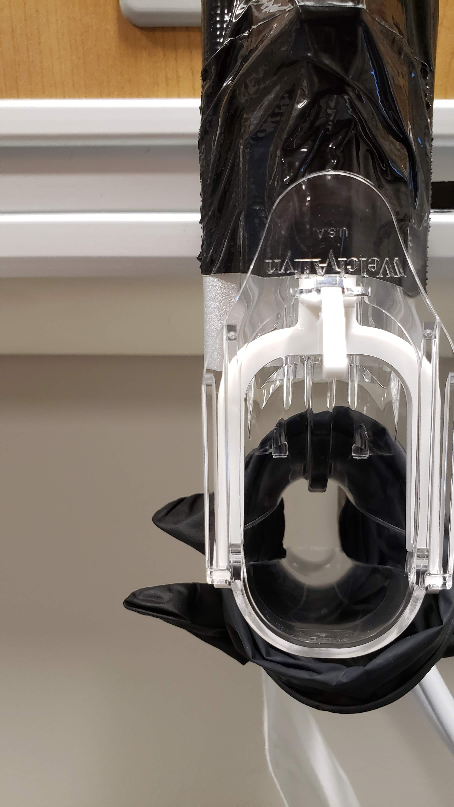
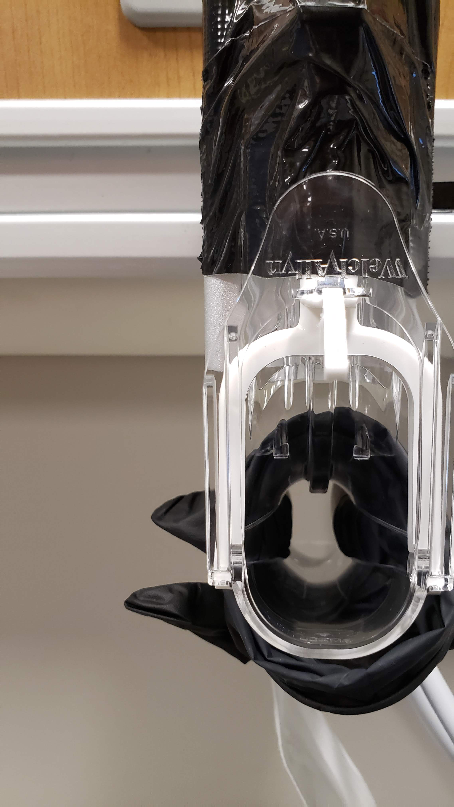
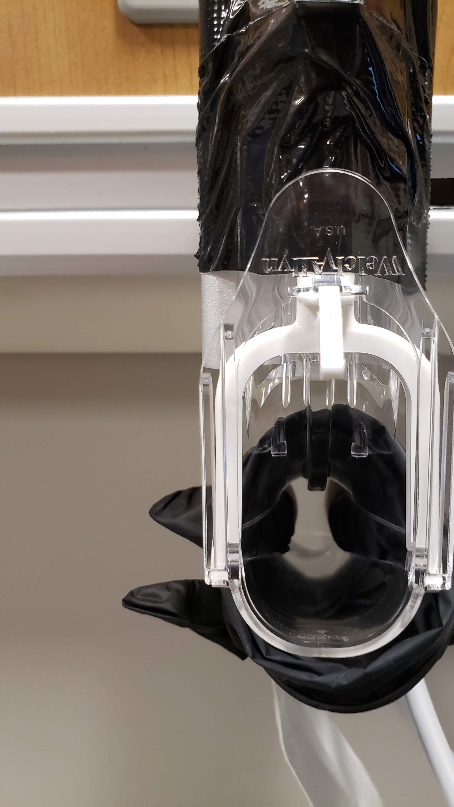
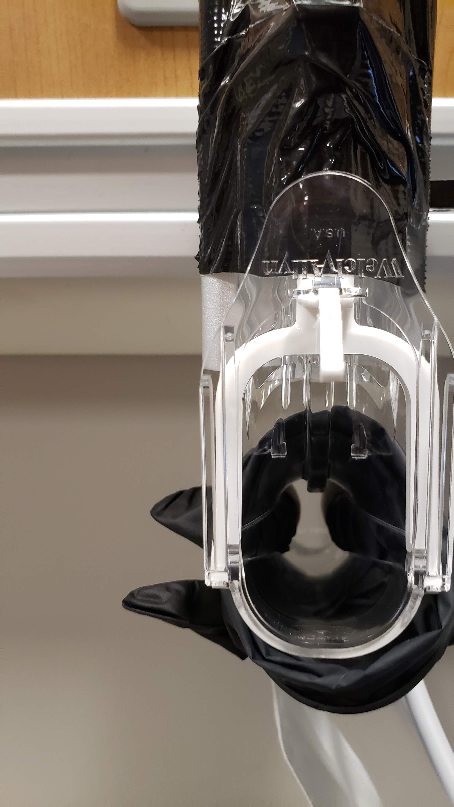
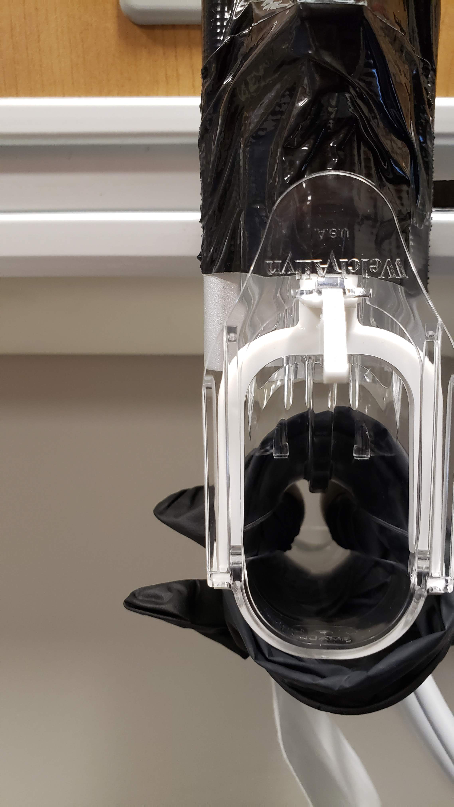
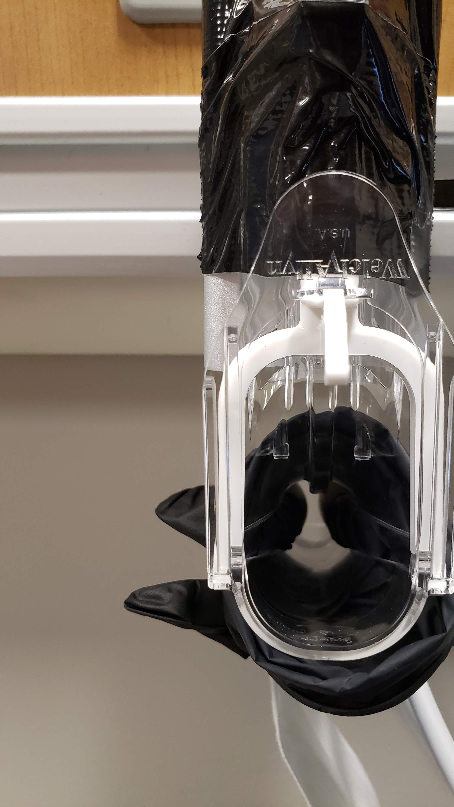

outputs/3_speculum_data_plots/Each Trial - Plotly/Trial 1) 'Middle finger' method with M. nitrile glove, Trial #1, n=5.jpg


In [18]:
plot_combined_images_plotly(order_current=1, save_extensions=["jpg"], n=5, annotate_extra_info=False)
#plot_combined_images_plotly(order_current=1, save_extensions=["svg"], n=4, annotate_extra_info=False)

## Plot Individual trial level data

In [ ]:
df_sampled = df_long.loc[ (df_long["Material"]=="Nitrile") & (df_long["Method"]=="Middle") & (df_long["Size"]=="M") ]
df_sampled["Trial"] = df_sampled["Trial"].astype(str)
fig = px.bar(df_sampled, 
             x="mmHg", y="wd_rel",  
             text_auto=".1%", barmode='group', color="Trial",
             title="Speculum View Width - Specific Trials", 
             hover_data=["Size","Material","Method","Trial"],
             category_orders=category_orders,
             labels=labels,
             color_discrete_map={"1": "Lightgray", "2": "Darkgray", "3": "Gray"},
             template="simple_white"
)


fig.update_layout(width=500, height=300)

fig.show()
save_plotly_figure(fig, file_name="Basic, all trials", scale=4)

<IPython.core.display.Javascript object>

Get good pixel width sizes

In [ ]:
# 80mm * 1in/25.4mm * 300ppi/4 (if we use a scale of 4)
# 180mm * 1in/25.4mm * 300ppi/4 (if we use a scale of 4)
# 180mm * 1in/25.4mm * 300ppi/4 (if we use a scale of 4)
80 * 1/25.4 * 300/4, 180 * 1/25.4 * 300/4

250 / (1/25.4 * 300/4), 550 / (1/25.4 * 300/4)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

(84.66666666666666, 186.26666666666665)

## Old plots

In [ ]:
fig = px.bar(df_long.loc[ (df_long["Material"]=="Nitrile") & (df_long["Method"]=="Middle") ], 
             x="mmHg", y="wd_rel", 
             text_auto=".1%", barmode='group', color="Size", 
             title="Speculum View Width", 
             hover_data=["Size","Material","Method","Trial"],
             category_orders={"Size": ["S", "M", "L"],"Material":["Nitrile","Vinyl"],"Method":["Middle","Two"],"Speculum Type":["White","Green"]},
             labels={"wd_rel":"View width","mmHg":"Pressure (mmHg)","Material":"Glove Material"},
             )
fig.show()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:

fig = px.bar(df_long.loc[ (df_long["Material"]=="Nitrile") & (df_long["Method"]=="Middle") ],
             x="mmHg", y="wd_rel", facet_row="Size", text_auto=".1%",
             title="Speculum View Width", 
             hover_data=["Size","Material","Method","Trial"],
             category_orders={"Size": ["S", "M", "L"],"Material":["Nitrile","Vinyl"],"Method":["Middle","Two"],"Speculum Type":["White","Green"]},
             labels={"wd_rel":"View width","mmHg":"Pressure (mmHg)","Material":"Glove Material"},
             )
fig.show()

## Table styling

In [ ]:
#anova_tabless.loc[:,pd.IndexSlice[:,"PR(>F)"]] = anova_tabless.loc[:,pd.IndexSlice[:,"PR(>F)"]].applymap(lambda p: str(p)+''.join(['*' for alpha in [0.001,0.01,0.05] if p<=alpha]))
def apply_table_styling(styled, varying, criteria, anova_types:list=None):
    style_props = [dict(selector="caption",props=[("text-align", "left"),
                   ("font-size", "180%"), ("font-weight","bold"),
                   ]),
               dict(selector='th.col_heading.level0', props=[('font-size','120%;')]),
               dict(selector='th.col_heading', props=[('text-align','center')]) 
               ]
    styled = styled.format(na_rep=" ", precision=4)
    styled = styled.format("{:.0f}",  subset=pd.IndexSlice[:,pd.IndexSlice[:,"df"]])
    styled = styled.applymap(lambda x: f"color: {'red' if x<=0.01 else ('orange' if x<=0.05 else 'black')}",subset=pd.IndexSlice[:,pd.IndexSlice[:,"PR(>F)"]])
    styled = styled.set_caption(f"Varying {varying} with " + criteria_to_str(criteria)).set_table_styles(style_props)
    if anova_types is not None:
        styled = styled.applymap((lambda x: f"opacity: 0.5"),subset=pd.IndexSlice[[f"Type {ind} ANOVA" for ind in range(1,4) if ind not in anova_types],:])
    return styled

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## ANOVA

In [ ]:
type(styled.get_caption())

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

AttributeError: ignored

In [ ]:
#criteria = [{"Material Type":"Glove","Material":"Nitrile", "mmHg":(ind*40)} for ind in range(6)]
criteria = {"Material Type":"Glove","Material":"Nitrile"}
varying = "Size"

anova_tabless = {}
for ind in range(6):
    criteria_specific = criteria.copy()
    criteria_specific["mmHg"] = ind*40
    #criteria = criterias[ind]
    df_sampled = filter_by_criteria(criteria_specific,df_long)
    
    # Ordinary Least Squares (OLS) model
    model = smf.ols(f"wd_rel ~ C(Q('{varying}'))", data=df_sampled)
    ols_result = model.fit()
    # See article for ANOVA types: https://towardsdatascience.com/anovas-three-types-of-estimating-sums-of-squares-don-t-make-the-wrong-choice-91107c77a27a
    # For type 1, the first argument will be assumed to be the most important
    types = [1,2,3]
    anova_tables = pd.concat(
        [sm.stats.anova_lm(ols_result, typ=type) for type in types],
        axis=1, keys=[f"Type {type} ANOVA" for type in types])
    anova_tabless[f"{criteria_specific['Material Type']} at {criteria_specific['mmHg']}mmHg"] = anova_tables

anova_tabless = pd.concat(anova_tabless,axis=0,keys=[f"{criteria['Material Type']} at {ind*40}mmHg" for ind in range(6)])

styled = anova_tabless.style
apply_table_styling(styled, varying, criteria)
styled = styled.applymap((lambda x: f"opacity: 0.5"),subset=pd.IndexSlice[:,[f"Type {ind} ANOVA" for ind in [2,3]]])
display(styled)
styled.to_excel(f"outputs/tables/ANOVA_{styled.caption}.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:1752: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 2, but rank is 0
  'rank is %d' % (J, J_), ValueWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:1768: RuntimeWarning: invalid value encountered in true_divide
  F /= J
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:1752: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 1, but rank is 0
  'rank is %d' % (J, J_), ValueWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:1752: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 2, but rank is 0
  'rank is %d' % (J, J_), ValueWarning)


In [ ]:
criteria = {"Material Type":"Condom"}
varying = "Material"

#df_sampled = df_long.loc[ np.all([ (type(val)!=list and df_long[arg]==val ) or np.in1d(df_long[arg],val)  for arg, val in criteria.items()], axis=0) ]
df_sampled = filter_by_criteria(criteria,df_long)
df_sampled.loc[:,"mmHg"] = df_sampled["mmHg"].astype(np.int64)

ys = [("wd","Width (wd)"),("wd_rel","Width % (wd_rel)")]
anova_tabless = {}
types = [1,2,3]
for anova_type in types:
    anova_tables = []
    for ind, (y, y_name) in enumerate(ys):
        # Ordinary Least Squares (OLS) model
        model = smf.ols(f"{y} ~ mmHg + C(Q('{varying}'))", data=df_sampled)
        ols_result = model.fit()
        # See article for ANOVA types: https://towardsdatascience.com/anovas-three-types-of-estimating-sums-of-squares-don-t-make-the-wrong-choice-91107c77a27a
        # For type 1, the first argument will be assumed to be the most important
        
        anova_tables.append( sm.stats.anova_lm(ols_result, typ=anova_type) )
    anova_tabless[f"Type {anova_type} ANOVA"] = pd.concat(anova_tables, axis=1, keys = [y_name for y,y_name in ys]) 

anova_tabless = pd.concat(anova_tabless.values(), axis=0, keys=anova_tabless.keys())

styled = anova_tabless.style
apply_table_styling(styled, varying, criteria, anova_types=[1])
display(styled)
styled.to_excel(f"outputs/tables/ANOVA_{styled.caption}.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1773: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


In [ ]:
criteria = {"Material Type":"Glove","Material":"Nitrile"}
varying = "Size"

df_sampled = filter_by_criteria(criteria,df_long)
df_sampled.loc[:,"mmHg"] = df_sampled["mmHg"].astype(np.int64)

ys = [("wd","Width (wd)"),("wd_rel","Width % (wd_rel)")]
anova_tabless = {}
types = [1,2,3]
for anova_type in types:
    anova_tables = []
    for ind, (y, y_name) in enumerate(ys):
        # Ordinary Least Squares (OLS) model
        model = smf.ols(f"{y} ~ mmHg + C(Q('{varying}'))", data=df_sampled)
        ols_result = model.fit()
        # See article for ANOVA types: https://towardsdatascience.com/anovas-three-types-of-estimating-sums-of-squares-don-t-make-the-wrong-choice-91107c77a27a
        # For type 1, the first argument will be assumed to be the most important
        
        anova_tables.append( sm.stats.anova_lm(ols_result, typ=anova_type) )
    anova_tabless[f"Type {anova_type} ANOVA"] = pd.concat(anova_tables, axis=1, keys = [y_name for y,y_name in ys]) 

anova_tabless = pd.concat(anova_tabless.values(), axis=0, keys=anova_tabless.keys())

styled = anova_tabless.style
apply_table_styling(styled, varying, criteria, anova_types=[1])
styled = styled.applymap((lambda x: f"opacity: 0.5"),subset=pd.IndexSlice[["Type 2 ANOVA", "Type 3 ANOVA"],:])
display(styled)
#styled.to_excel(f"outputs/tables/ANOVA_{styled.caption}.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1773: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


In [ ]:
criteria = {"Material Type":["Glove"],"Material":["Nitrile"]}

df_sampled = filter_by_criteria(criteria,df_long)

# Ordinary Least Squares (OLS) model
model = smf.ols("wd_rel ~ mmHg + C(Q('Size'))", data=df_sampled)
ols_result = model.fit()
# See article for ANOVA types: https://towardsdatascience.com/anovas-three-types-of-estimating-sums-of-squares-don-t-make-the-wrong-choice-91107c77a27a
# For type 1, the first argument will be assumed to be the most important
types = [1,2,3]
anova_tables = pd.concat(
    [sm.stats.anova_lm(ols_result, typ=type) for type in types],
    axis=1, keys=[f"ANOVA Type {type}" for type in types])
display(anova_tables)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

ANOVA Type 1                                               \
                       df    sum_sq   mean_sq          F        PR(>F)   
mmHg                  5.0  6.185988  1.237198  85.293628  5.876338e-27   
C(Q('Size'))          2.0  0.137872  0.068936   4.752524  1.190172e-02   
Residual             64.0  0.928330  0.014505        NaN           NaN   
Intercept             NaN       NaN       NaN        NaN           NaN   

             ANOVA Type 2                                ANOVA Type 3        \
                   sum_sq    df          F        PR(>F)       sum_sq    df   
mmHg             6.185988   5.0  85.293628  5.876338e-27     6.185988   5.0   
C(Q('Size'))     0.137872   2.0   4.752524  1.190172e-02     0.137872   2.0   
Residual         0.928330  64.0        NaN           NaN     0.928330  64.0   
Intercept             NaN   NaN        NaN           NaN     0.041233   1.0   

                                       
                      F        PR(>F)  
mmHg          85.293628  5.876338e-27  
C(Q('Size'))   4.752524  1.190172e-02  
Residual            NaN           NaN  
Intercept      2.842637  9.666324e-02

## Models

In [ ]:
df_long.head()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

,Order,Speculum Type,Spec Ang,Spec Ht,Size,Material,Material Type,Method,Trial,Vertical Height,mmHg,Filename,url,Label ID,wd,ht,wd_rel,ht_rel
0,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,0,20220423_142023.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cez4xr5ki20zagcvnuf7sk,257.0,261.0,0.000000,0.000000
1,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,40,20220423_142031.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cf020i5j8u0zdfhye4ehjg,190.0,287.0,0.260700,-0.099617
2,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,80,20220423_142049.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cf0jjk5jak0zdf8j436nbt,120.0,252.0,0.533074,0.034483
3,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,120,20220423_142054.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cf0z834fgl0zbx37jcdzhz,90.0,250.0,0.649805,0.042146
4,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,160,20220423_142100.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cez4r95jdf0zam6uu20850,65.0,361.0,0.747082,-0.383142


In [ ]:
df_long['Material Type']

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

0      Glove
1      Glove
2      Glove
3      Glove
4      Glove
       ...  
176     None
177     None
178     None
179     None
180     None
Name: Material Type, Length: 181, dtype: object

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

                            OLS Regression Results                            
Dep. Variable:                 wd_rel   R-squared:                       0.501
Model:                            OLS   Adj. R-squared:                  0.480
Method:                 Least Squares   F-statistic:                     23.91
Date:                Sun, 01 May 2022   Prob (F-statistic):           1.83e-19
Time:                        19:52:19   Log-Likelihood:                 10.218
No. Observations:                 150   AIC:                            -6.436
Df Residuals:                     143   BIC:                             14.64
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept   

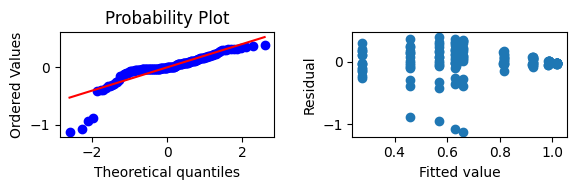

In [ ]:
criteria = {"mmHg":[40,80,120,160,200]}
#varying = "Material"

df_sampled = df_long.loc[ np.all([ (type(val)!=list and df_long[arg]==val ) or np.in1d(df_long[arg],val)  for arg, val in criteria.items()], axis=0) ]

formula = "wd_rel ~ mmHg + C(Q('Material Type')) + C(Material) + C(Size)"
model = smf.ols(formula = formula, data=df_sampled)
ols_result = model.fit()


fig, axs = plt.subplots(1,2, figsize=(6,2), dpi=100)
_ = scipy.stats.probplot(ols_result.resid, plot=axs[0])
#plt.figure()
axs[1].scatter(ols_result.fittedvalues, ols_result.resid)
axs[1].set_xlabel('Fitted value')
axs[1].set_ylabel('Residual')
fig.tight_layout()

print(ols_result.summary())


In [ ]:
df_long

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

,Order,Speculum Type,Spec Ang,Spec Ht,Size,Material,Material Type,Method,Trial,Vertical Height,mmHg,Filename,url,Label ID,wd,ht,wd_rel,ht_rel
0,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,0,20220423_142023.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cez4xr5ki20zagcvnuf7sk,257.0,261.0,0.000000,0.000000
1,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,40,20220423_142031.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cf020i5j8u0zdfhye4ehjg,190.0,287.0,0.260700,-0.099617
2,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,80,20220423_142049.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cf0jjk5jak0zdf8j436nbt,120.0,252.0,0.533074,0.034483
3,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,120,20220423_142054.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cf0z834fgl0zbx37jcdzhz,90.0,250.0,0.649805,0.042146
4,1,White,5,0,M,Nitrile,Glove,Middle,1,2.7,160,20220423_142100.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2cez4r95jdf0zam6uu20850,65.0,361.0,0.747082,-0.383142
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
176,36,White,3,0,None,None,None,None,3,4.1,40,20220423_172235.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2hvx3u007nd107h64biho7u,100.0,392.0,0.615385,-0.015544
177,36,White,3,0,None,None,None,None,3,4.1,80,20220423_172239.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2hvxqgj0a450z8304rfe8au,58.0,364.0,0.776923,0.056995
178,36,White,3,0,None,None,None,None,3,4.1,120,20220423_172242.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2hvy0dw0a1j0zard6uo47jm,30.0,335.0,0.884615,0.132124
179,36,White,3,0,None,None,None,None,3,4.1,160,20220423_172246.jpg,https://storage.labelbox.com/cl2ceiao35hbj0zah...,cl2hvyahh0a7s0z83elgpcx57,19.0,307.0,0.926923,0.204663


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

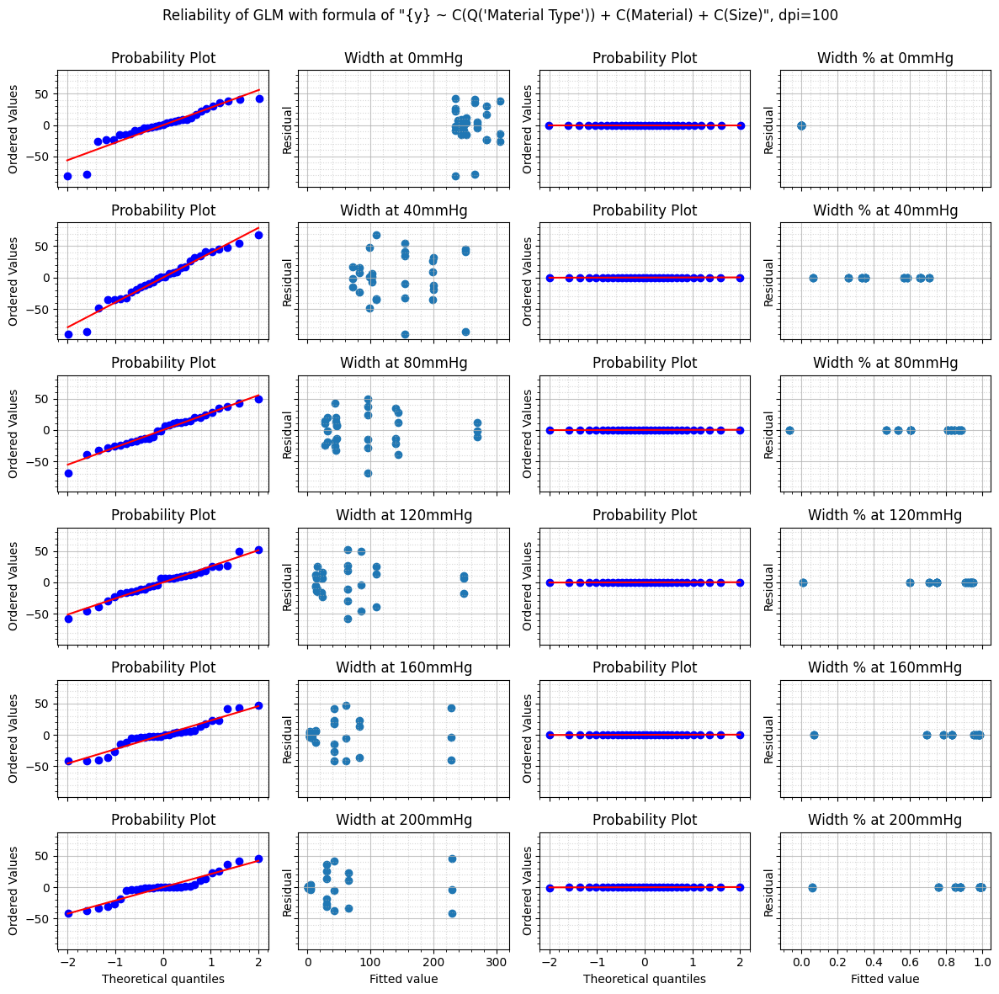

In [ ]:
gen_formula = "{y} ~ C(Q('Material Type')) + C(Material) + C(Size)"
nrows=6
fig, axes = plt.subplots(nrows,4, figsize=(12,2*nrows), dpi=100, sharex="col", sharey="all")
for ind in range(nrows):
    mmHg = 40*ind
    criteria = {"mmHg":[mmHg]}
    df_sampled = df_long.loc[ np.all([ (type(val)!=list and df_long[arg]==val ) or np.in1d(df_long[arg],val)  for arg, val in criteria.items()], axis=0) ]
    
    ys = [("wd","Width"),("wd_rel","Width %")]
    for ind2, (y,y_name) in enumerate(ys):
        #display(df_sampled.head())
        formula = gen_formula.format(y=y)
        model = smf.ols(formula = formula, data=df_sampled)
        ols_result = model.fit()

        _ = scipy.stats.probplot(ols_result.resid, plot=axes[ind,0+ind2*2])
        if ind < nrows-1:
            axes[ind,0+ind2*2].set_xlabel("")

        #plt.figure()
        axes[ind,1+ind2*2].scatter(ols_result.fittedvalues, ols_result.resid)
        axes[ind,1+ind2*2].set_ylabel('Residual')
        axes[ind,1+ind2*2].set_title(f"{y_name} at {mmHg}mmHg")

axes[-1,1].set_xlabel('Fitted value')
axes[-1,3].set_xlabel('Fitted value')

for ind,ax in enumerate(axes.flat):
    ax.grid(which="major", alpha=0.75)  # set major grid lines
    ax.grid(which="minor", alpha=0.5, linestyle=":")  # set minor grid lines, but make them less visible
    ax.xaxis.set_minor_locator(matplotlib.ticker.AutoMinorLocator())
    ax.yaxis.set_minor_locator(matplotlib.ticker.AutoMinorLocator())

dpi = fig.dpi
title = f"Reliability of GLM with formula of \"{gen_formula}\""+ f", dpi={dpi}".replace("{","").replace("}","")
fig.suptitle(title)
fig.tight_layout(rect=[0,0,1,0.95] )  # rect=[left, bottom, right top]

plt.savefig(get_path_to_save(save_filename=title), 
            bbox_inches='tight')  # Include the bbox_inches='tight' is critical to ensure the saved images aren't cutoff while the colab images are normal


In [ ]:
# Poisson regression code
import statsmodels.api as sm
import statsmodels.formula.api as smf

formula = "Q('Vertical Height') ~ C(Material)"
model = smf.glm(formula = formula, data=df_long, family=sm.families.Binomial())
#model = smf.glm(formula = formula, data=df_wide_flat)
result = model.fit()
print(result.summary())

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

                  Generalized Linear Model Regression Results                   
Dep. Variable:     Q('Vertical Height')   No. Observations:                  181
Model:                              GLM   Df Residuals:                      174
Model Family:                  Binomial   Df Model:                            6
Link Function:                    logit   Scale:                          1.0000
Method:                            IRLS   Log-Likelihood:                    nan
Date:                  Sun, 01 May 2022   Deviance:                          nan
Time:                          19:23:55   Pearson chi2:                 5.35e+18
No. Iterations:                     100                                         
Covariance Type:              nonrobust                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
Inte

/usr/local/lib/python3.7/dist-packages/statsmodels/genmod/families/family.py:890: RuntimeWarning: divide by zero encountered in true_divide
  n_endog_mu = self._clean((1. - endog) / (1. - mu))
/usr/local/lib/python3.7/dist-packages/statsmodels/genmod/families/family.py:890: RuntimeWarning: invalid value encountered in true_divide
  n_endog_mu = self._clean((1. - endog) / (1. - mu))
/usr/local/lib/python3.7/dist-packages/statsmodels/genmod/families/family.py:942: RuntimeWarning: divide by zero encountered in true_divide
  special.gammaln(n - y + 1) + y * np.log(mu / (1 - mu)) +
/usr/local/lib/python3.7/dist-packages/statsmodels/genmod/families/family.py:942: RuntimeWarning: invalid value encountered in add
  special.gammaln(n - y + 1) + y * np.log(mu / (1 - mu)) +
/usr/local/lib/python3.7/dist-packages/statsmodels/genmod/families/family.py:943: RuntimeWarning: divide by zero encountered in log
  n * np.log(1 - mu)) * var_weights
/usr/local/lib/python3.7/dist-packages/statsmodels/genmod/

In [ ]:
exog, endog = sm.add_constant(x), y
mod = sm.GLM(endog, exog,
             family=sm.families.Poisson(link=sm.families.links.log))
res = mod.fit()